In [9]:
import pandas as pd 
import numpy as np 
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge,RidgeCV,Lasso,LassoCV,ElasticNet,ElasticNetCV,LogisticRegression
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score,roc_curve,roc_auc_score,confusion_matrix
import matplotlib.pyplot as plt 
import seaborn as sns 
from pandas_profiling import ProfileReport
import pickle

In [3]:
df=pd.read_csv("https://raw.githubusercontent.com//plotly/datasets/master/diabetes.csv")
df # this is a classification problem 
# problem staatement whether a person have diabetes or not?

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [10]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:01<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
df.info()
# there is no null values 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


In [12]:
# after looking into report we find that there is no null values
#  outliers are present 
# some column have are right skewed 

In [13]:
# for a living person these things can't be zero 
# BMI has some zero values 
# Insulin 
# Skin Thickness 
# Blood Pressure 
# Glucose 

# due to some error we are getting zero values 
# we have to handle it 

### replacing 0 with mean

In [14]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [15]:
a=['Glucose','BloodPressure','SkinThickness','Insulin','BMI']
for i in a:
    df[i]=df[i].replace(0,df[i].mean())

In [21]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [22]:
# zero values are handled 
# now check for outliers 

<AxesSubplot:>

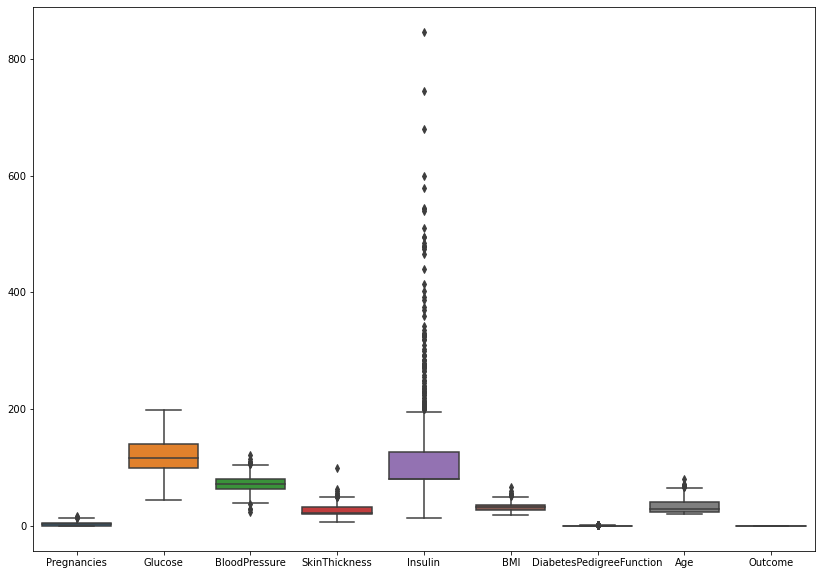

In [32]:
fig,ax=plt.subplots(figsize=(14,10))
sns.boxplot(data=df,ax=ax)

<AxesSubplot:>

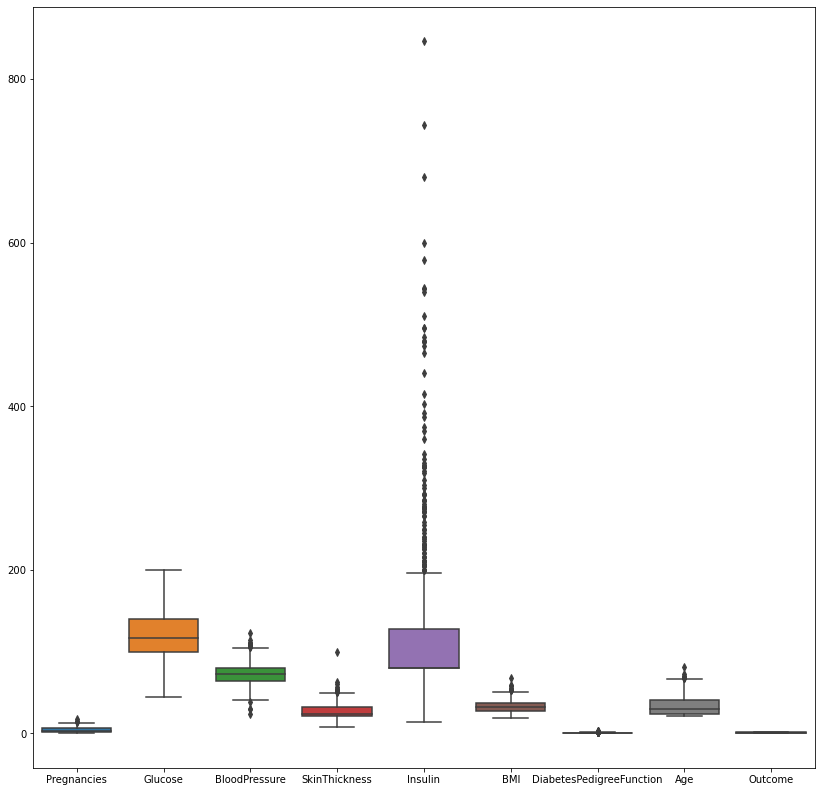

In [31]:
plt.figure(figsize=(14,14))
sns.boxplot(data=df)

<AxesSubplot:>

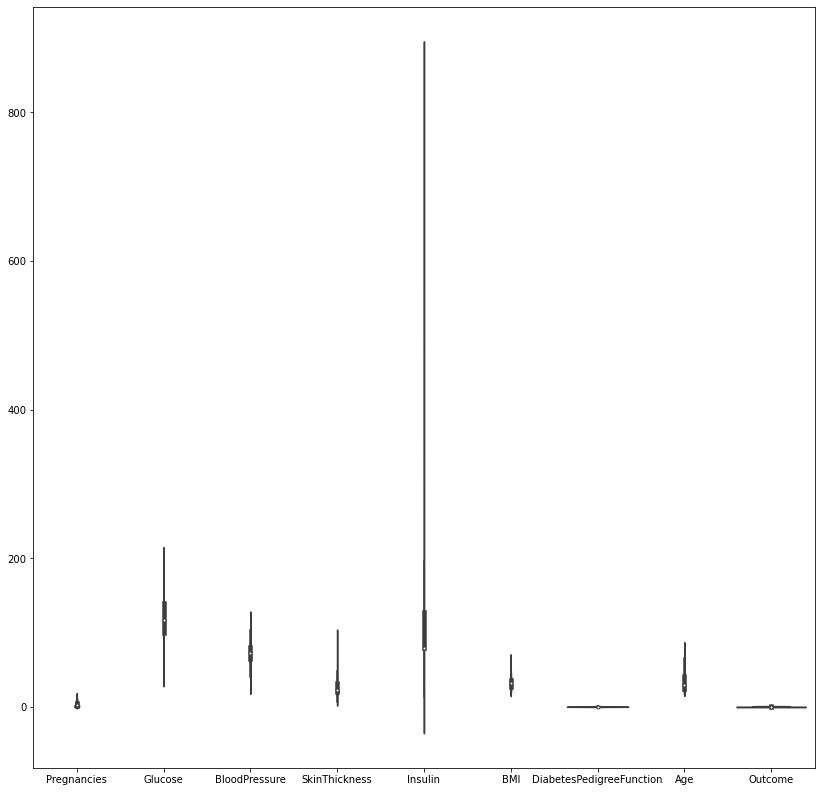

In [34]:
plt.figure(figsize=(14,14))
sns.violinplot(data=df)

<AxesSubplot:>

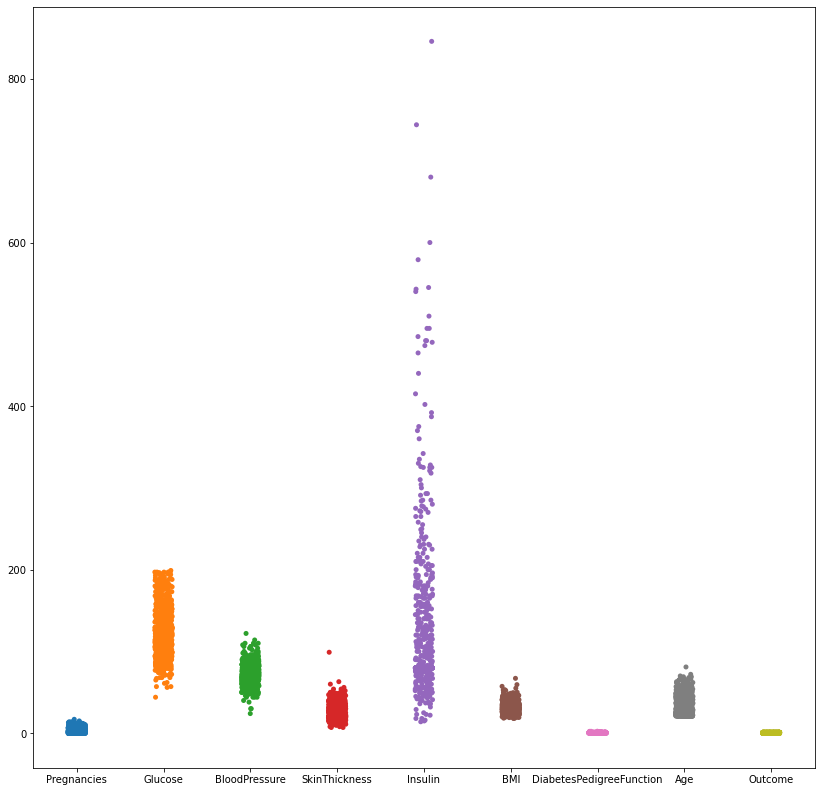

In [35]:
plt.figure(figsize=(14,14))
sns.stripplot(data=df)

<Figure size 1008x1008 with 0 Axes>

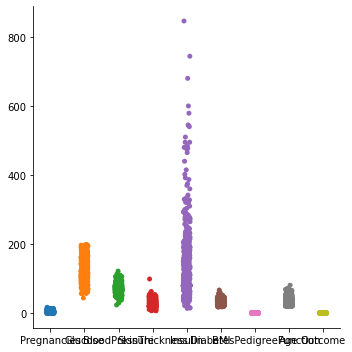

In [36]:
plt.figure(figsize=(14,14))
sns.catplot(data=df)

<AxesSubplot:>

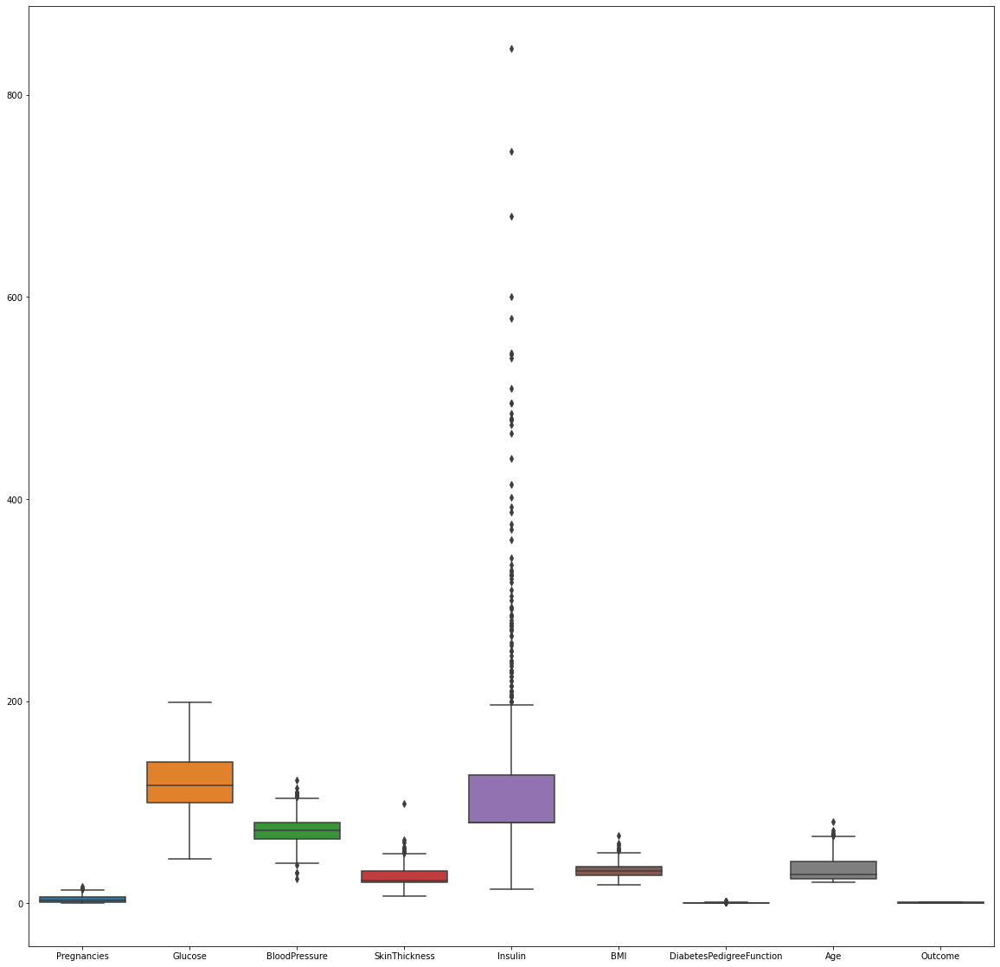

In [37]:
plt.figure(figsize=(20,20))
sns.boxplot(data=df)

In [38]:
# blood pressure,skinthickness,insulin,Bmi,age have outliers 

In [39]:
# handling outliers 
# 1. IQR
# 2. log transform 
# 3. square root
# 4. BOXcox
# 5. remove the some data (but we loose data in this )

In [44]:
q=df["Insulin"].quantile(0.90)  # keeping only 90 values 
df_new=df[df["Insulin"]<q] # droping 10% values 
# saving df in df_new then selecting only insulin values which are less than 90%
# but it is effecting other data also bcz no.of rows are decaresing (we are dlting that rows)

<AxesSubplot:>

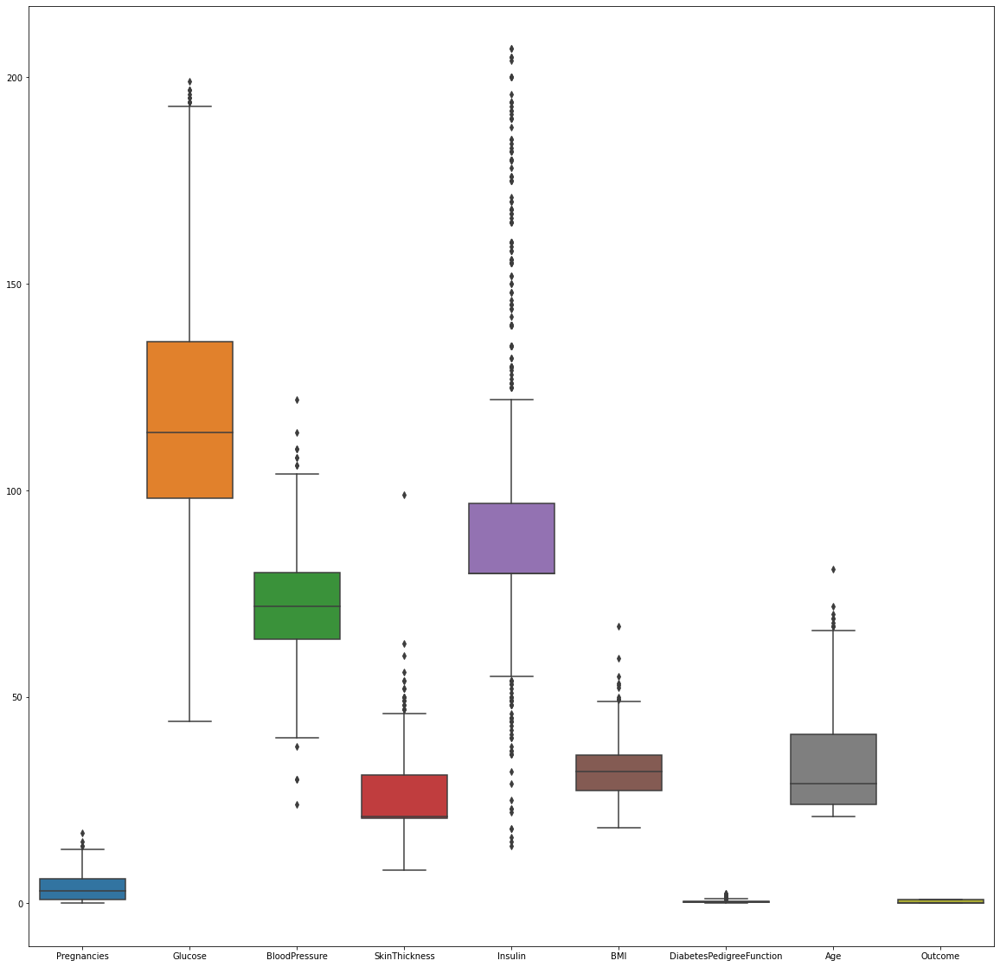

In [42]:
plt.figure(figsize=(20,20))
sns.boxplot(data=df_new)
# now we have outliers in glucose column 
# but in starting we don't have outliers 

In [43]:
df_new.info()
# in starting we have 768 values 
# and now we have 688 values 
# we are loosing values 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 688 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               688 non-null    int64  
 1   Glucose                   688 non-null    float64
 2   BloodPressure             688 non-null    float64
 3   SkinThickness             688 non-null    float64
 4   Insulin                   688 non-null    float64
 5   BMI                       688 non-null    float64
 6   DiabetesPedigreeFunction  688 non-null    float64
 7   Age                       688 non-null    int64  
 8   Outcome                   688 non-null    int64  
dtypes: float64(6), int64(3)
memory usage: 53.8 KB


In [45]:
# we have have some outliers in pregencies columns 
# and drooping 2% of data doesn;t effect our actual data 

In [46]:
q=df["Pregnancies"].quantile(.98) # keeping 98% data 
df_new=df[df["Pregnancies"]<q] # dropping 2% data 

<AxesSubplot:>

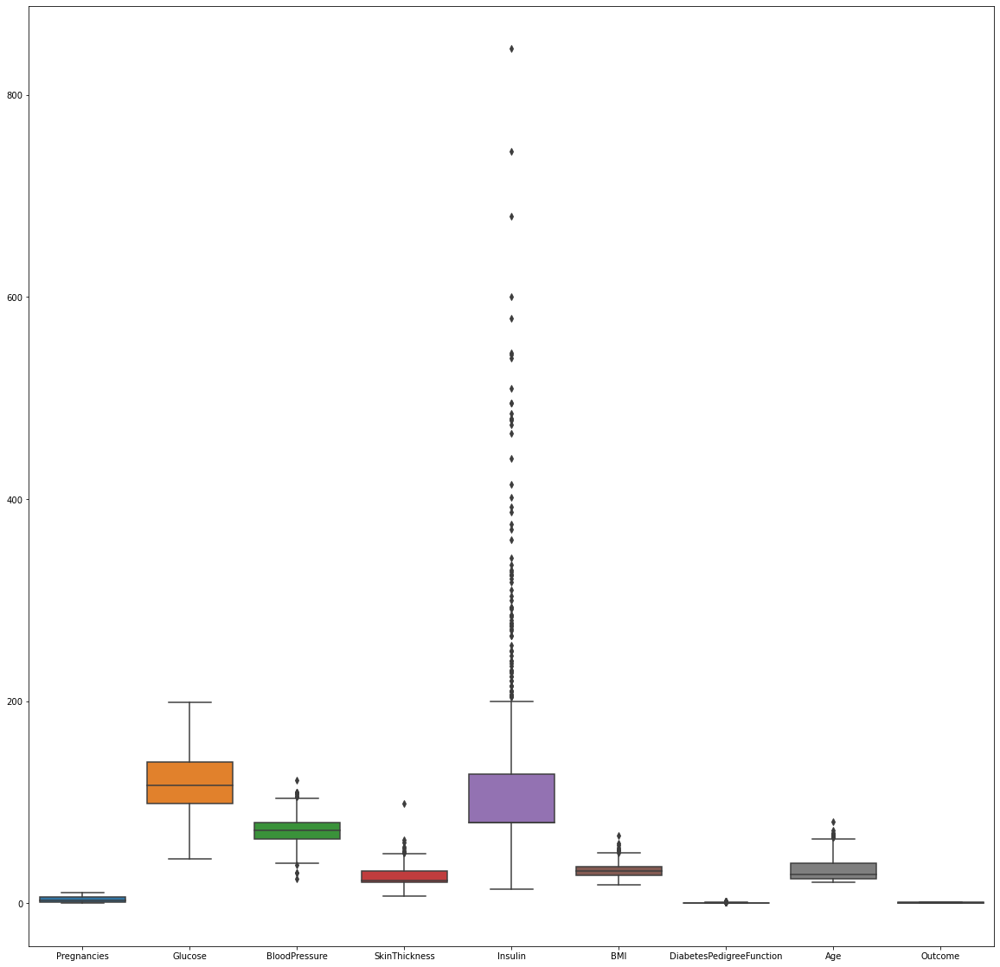

In [47]:
plt.figure(figsize=(20,20))
sns.boxplot(data=df_new)


In [48]:
# after droping 2% values 
# our pregnancies column is cleaned it have no outliers 

In [55]:
q=df["Pregnancies"].quantile(.98) 
df_new=df[df["Pregnancies"]<q]

q=df_new["BMI"].quantile(.99)
df_new=df_new[df_new["BMI"]<q]

q=df_new["Age"].quantile(.98)
df_new=df_new[df_new["Age"]<q]

q=df_new["SkinThickness"].quantile(.99)
df_new=df_new[df_new["SkinThickness"]<q]

q=df_new["BloodPressure"].quantile(.99)
df_new=df_new[df_new["BloodPressure"]<q]


<AxesSubplot:>

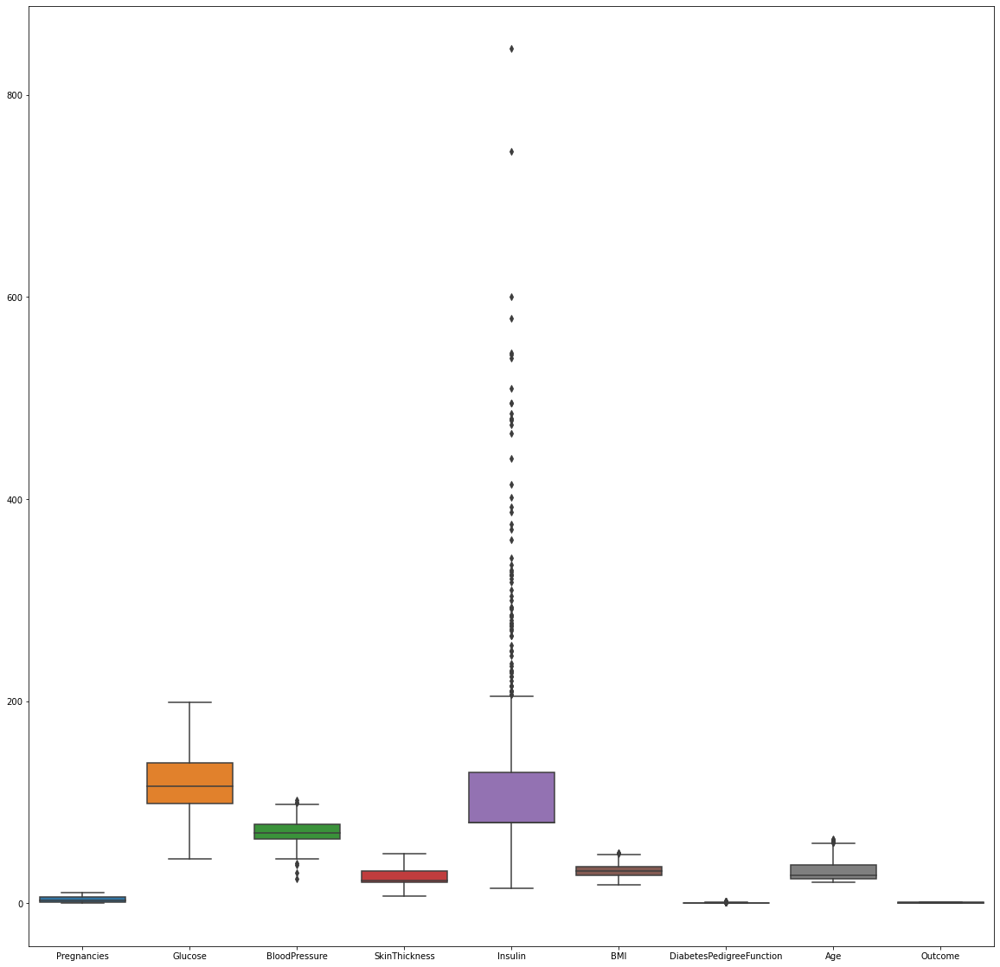

In [56]:
plt.figure(figsize=(20,20))
sns.boxplot(data=df_new)
# after droping 
# Glucose and BMI have not outliers 


<AxesSubplot:>

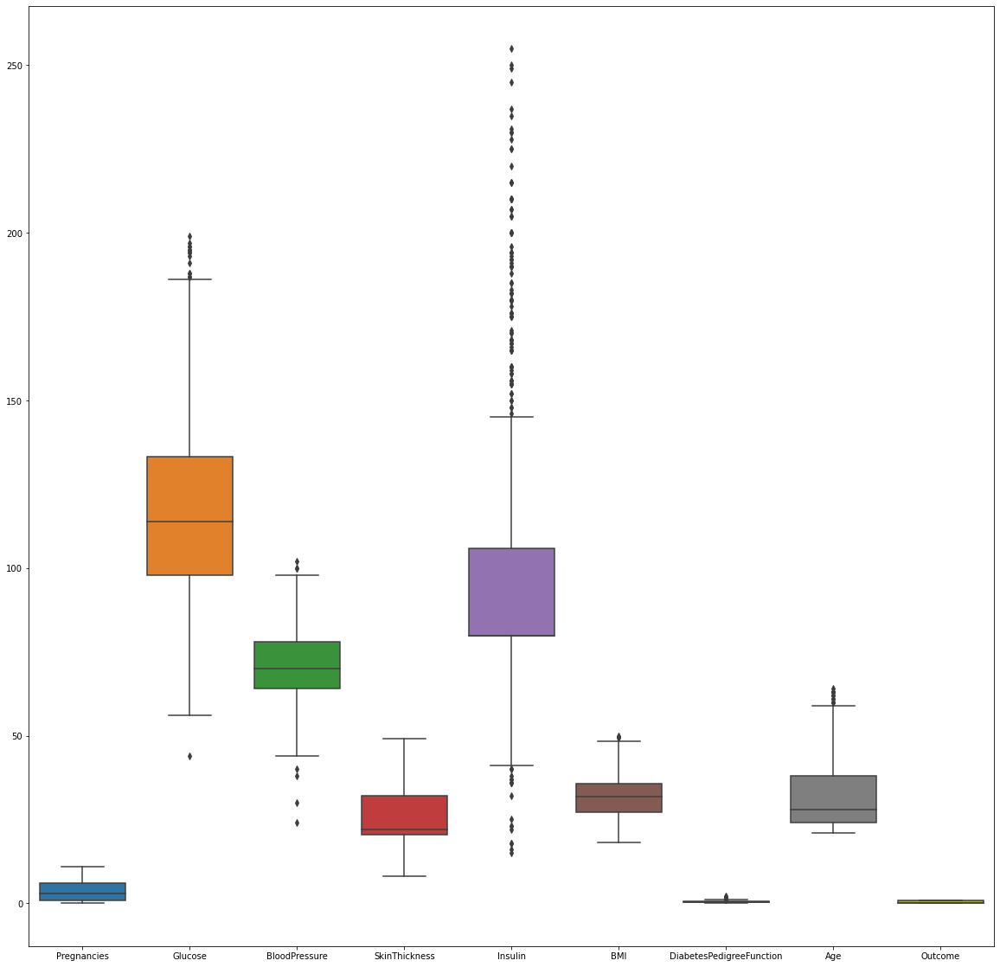

In [57]:
# but doing these also effecting other columns 
df_new=df_new[df_new["Insulin"]<df_new["Insulin"].quantile(.93)]
plt.figure(figsize=(20,20))
sns.boxplot(data=df_new)

In [59]:
df_new.info() # we are loosing so many values 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 652 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               652 non-null    int64  
 1   Glucose                   652 non-null    float64
 2   BloodPressure             652 non-null    float64
 3   SkinThickness             652 non-null    float64
 4   Insulin                   652 non-null    float64
 5   BMI                       652 non-null    float64
 6   DiabetesPedigreeFunction  652 non-null    float64
 7   Age                       652 non-null    int64  
 8   Outcome                   652 non-null    int64  
dtypes: float64(6), int64(3)
memory usage: 50.9 KB


In [63]:
x=df_new.drop("Outcome",axis=1)
y=df_new["Outcome"]

In [64]:
df_new.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,652.000000,652.000000,652.000000,652.000000,652.000000,652.000000,652.000000,652.000000,652.000000
mean,3.558282,118.060541,71.288919,25.729087,97.919363,31.816604,0.462255,31.907975,0.325153
std,3.000969,28.484628,11.106621,8.521853,42.903189,6.335754,0.315505,10.315937,0.468792
min,0.000000,44.000000,24.000000,8.000000,15.000000,18.200000,0.078000,21.000000,0.000000
25%,1.000000,98.000000,64.000000,20.536458,79.799479,27.300000,0.240750,24.000000,0.000000
50%,3.000000,114.000000,70.000000,22.000000,79.799479,31.946289,0.364500,28.000000,0.000000
75%,6.000000,133.250000,78.000000,32.000000,106.000000,35.800000,0.610500,38.000000,1.000000
max,11.000000,199.000000,102.000000,49.000000,255.000000,50.000000,2.288000,64.000000,1.000000


In [66]:
# in our data sets flucation is high 
# suppose insulin min=15 and max=255 same for other columns

# how to deal with this 

In [69]:
scaler=StandardScaler()
scaler.fit_transform(df_new)
ProfileReport(pd.DataFrame(scaler.fit_transform(df_new)))
# use standard scaler before train test split 
# bcz if we apply scaler later then our train and tests may have different scale 
# and these don't match with others 

# we are data scientist so there is a not a step step by processer
# every time we have to perform some experiments 
# which ever experiment is good 
# that we will use in production 

# 1+1 may be zero or one based on condition 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

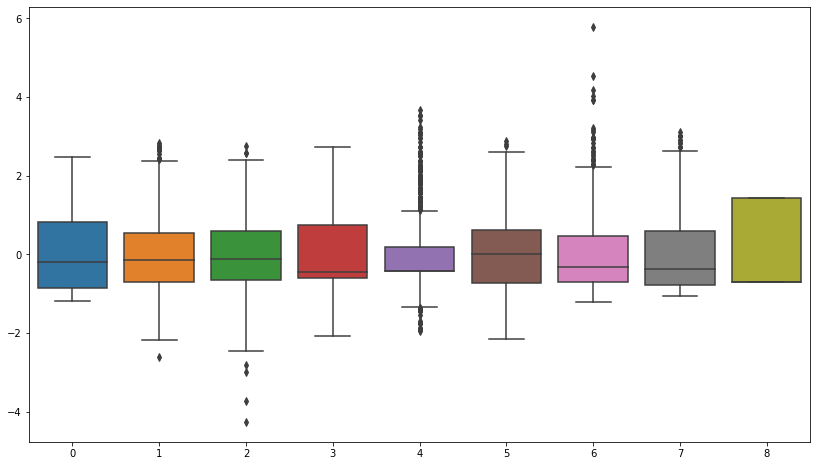

In [70]:
df_new_scale=(pd.DataFrame(scaler.fit_transform(df_new)))
plt.figure(figsize=(14,8))
sns.boxplot(data=df_new_scale)

<AxesSubplot:>

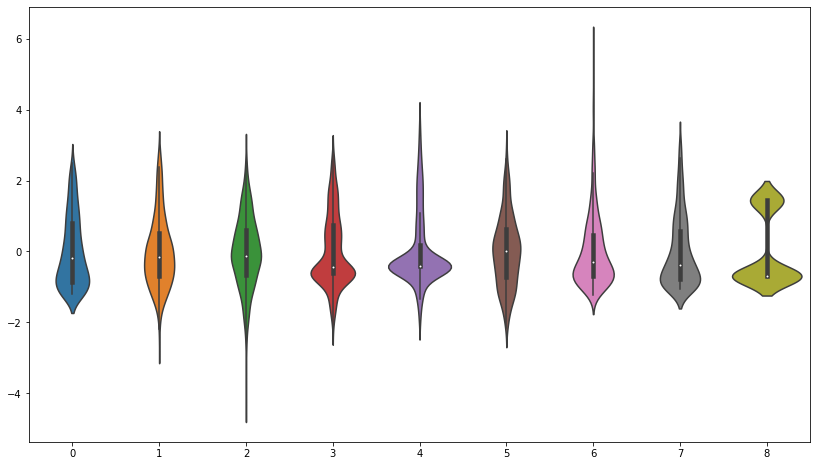

In [71]:
df_new_scale=(pd.DataFrame(scaler.fit_transform(df_new)))
plt.figure(figsize=(14,8))
sns.violinplot(data=df_new_scale)

<Figure size 1008x576 with 0 Axes>

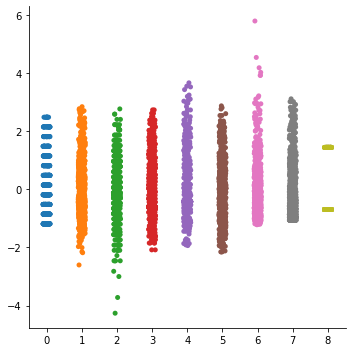

In [72]:
df_new_scale=(pd.DataFrame(scaler.fit_transform(df_new)))
plt.figure(figsize=(14,8))
sns.catplot(data=df_new_scale)

<AxesSubplot:>

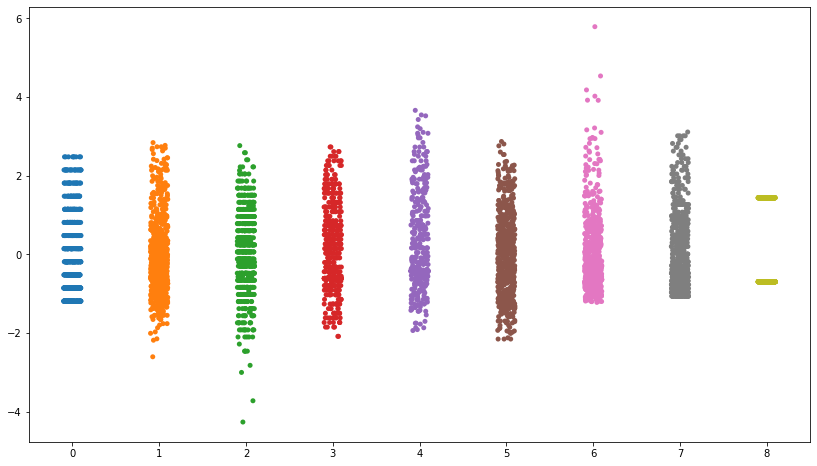

In [74]:
df_new_scale=(pd.DataFrame(scaler.fit_transform(df_new)))
plt.figure(figsize=(14,8))
sns.stripplot(data=df_new_scale)

C:\Users\visha\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 66.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\visha\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 32.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\visha\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 30.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\visha\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 49.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\visha\anaconda3\lib\site-packages\seaborn\categorical.py:1296: UserWarning: 8.3% of the points 

<AxesSubplot:>

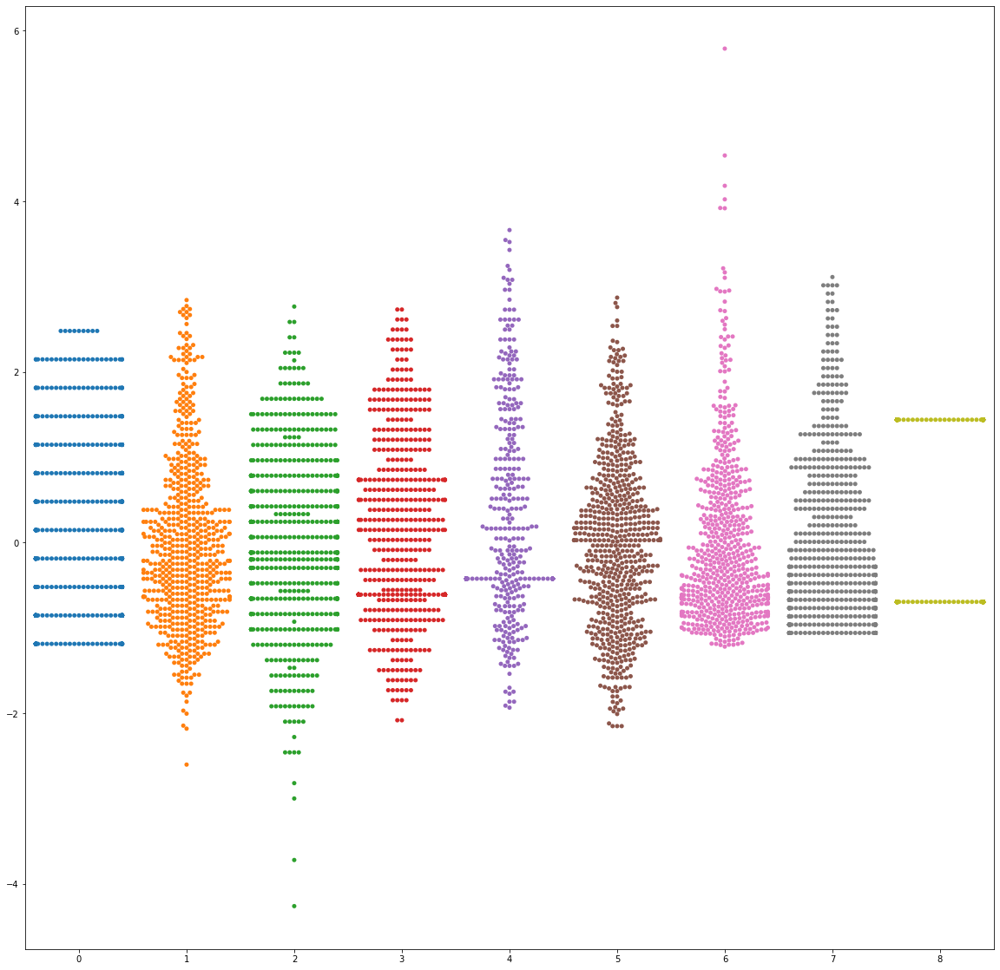

In [77]:
df_new_scale=(pd.DataFrame(scaler.fit_transform(df_new)))
plt.figure(figsize=(20,20))
sns.swarmplot(data=df_new_scale)

In [79]:
# checking multicolenarity 
# by heatmap we can also check 
arr1=scaler.fit_transform(x)
vif=[variance_inflation_factor(arr1,i) for i in range(arr1.shape[1])]
vif_df=pd.DataFrame()
vif_df["VIF_values"]=vif
vif_df["Features"]=x.columns
vif_df

,VIF_values,Features
0,1.504944,Pregnancies
1,1.266717,Glucose
2,1.226505,BloodPressure
3,1.515888,SkinThickness
4,1.275604,Insulin
5,1.512272,BMI
6,1.051658,DiabetesPedigreeFunction
7,1.682614,Age


<AxesSubplot:>

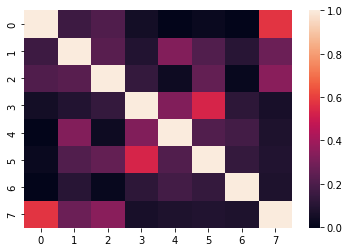

In [83]:
sns.heatmap(pd.DataFrame(arr1).corr())

In [1]:
# now same logistice regression apply 
# convert into train test split 
# it's binary classification so ovo(one verse one ) we use 
# if it's a multiclassification then ovr(one verse rest) we use 

In [ ]:
# what is solver? liblinear ? regulization ? newton-cg ? l1_ration?  cross-entropy loss? 
# study every thing inside logisticRegrssion()

In [ ]:
# open that multiclassification folder and combine them into one sheet and put a label column 
# only logistic regression will be used 
# try different solvers . liblinear is not applicable in this case ? 
# try to find the best model 
# auc curve 
# eda will be performed 
